# Comparing Dasymetic Mapping methods for City of Chesapeake, Viginia

The goal of this notebook is to explore dasymetric mapping mthods in City of Chesapeake, Virginia.

Dasymetric mapping is a technique used to improve the accuracy of population mapping. In the United States, census data is widely used to analyze the spatial distribution of socio-economic factors. For instance, the American Community Survey (ACS, available at https://www.census.gov/programs-surveys/acs) compiles crucial socio-economic data at the census tract level. While census boundaries cover entire states, the population is not evenly distributed but tends to concentrate in residential areas. Dasymetric mapping, in combination with other datasets like land use and land cover, enhances the precision of mapping results.

This notebook applies two python packages including:
1. Tobler, a geostatistic pytho package based on PySAL: https://github.com/pysal/tobler.
2. The EnviroAtlas Intelligent Dasymetric Toolbox: https://github.com/USEPA/Dasymetric-Toolbox-ArcGISPro

The steps are as follows:
1. Load Census, Open Street Map and land use land cover data for the residential area.
2. Apply Tobler package
3. Apply EPA package
4. Compare Tobler and EPA outcomes

In [16]:
# Import required python library
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.patches import Patch
from matplotlib.colors import ListedColormap # for land use land cover plotting

# GeoSpatial related
import geopandas as gpd
from census import Census

# Census and OpenStreetMap related
#import pygeoda
from pygris import block_groups, blocks
from pygris.data import get_census
import osmnx as ox

# Geospatial data process & analysis related
import rioxarray
from rasterio.plot import show
from shapely.geometry import Polygon, LineString, Point
from split_donuts import split_donuts # This function require the split_donuts.py in local folder
from join_donuts import join_donuts # This function require the join_donuts.py in local folder
from tobler.util import h3fy

#from libpysal import weights
#import esda

# Geostatistic for dasymetric mapping 
import pysal
from tobler.area_weighted import area_interpolate
from tobler.dasymetric import masked_area_interpolate


# 1.1 Loading population data from the U.S. Census Bureau

There are several python package can be used to import data from U.S. Census Bureau. Here, pygris is utilized to retrieve Census Bureau TIGER/Line and cartographic boundary shapefiles and load them into Python as GeoDataFrames. For more infromation, see: https://walker-data.com/pygris/

Note that census block group data is retrieved here because the size if block group has similar size to OSM residential polygons.

In [2]:
# Load census block group data with pygris "block_groups" function as a GeoDataFrame
cpc_cbg = blocks(state = "VA", county = "Chesapeake", year = 2020, cache = True)

Using FIPS code '51' for input 'VA'
Using FIPS code '550' for input 'Chesapeake'


In [3]:
# Make an interactive map to view the GeoDataFrame
cpc_cbg.explore(tooltip = False, popup = True ) #shows data when clicking

In [4]:
# Create a boundary "AOI" for study area for later process
AOI = cpc_cbg.copy()
AOI['disso'] = 1
AOI = AOI.dissolve(by='disso')
AOI = AOI.to_crs("epsg:32618")

In [5]:
# Import census data, here census block data is first retrieved
CPC_data = get_census(
    dataset = "dec/dhc", # Decennial Census & Census Demographic and Housing Characteristics
    year = 2020,
    variables = ["P1_001N", # total population
                 "P5_003N", # total non-Hispanic white population
                 "P10_004N", #total population of African American
                 "P12_020N", # Variables P12_020N to P12_025N are total population for males ages 65 and over
                 "P12Z_003N", # males under 5 years old
                 "P12_021N",
                 "P12_022N",
                 "P12_023N",
                 "P12_024N",
                 "P12_025N",
                 "P12_044N", # Variables P12_044N to P12_049N are total population for females ages 65 and over
                 "P12_045N",
                 "P12_046N",
                 "P12_047N",
                 "P12_048N",
                 "P12_049N",
                 "P12Z_027N" # females under 5 years old
                ],
    params = {
        "for": "block:*",
        "in": ["state:51", "county:550"] # here define the State / County code, CPC code as 
    },
    return_geoid = True,
    guess_dtypes = True
)

# Preview census data
CPC_data.head()

,P1_001N,P5_003N,P10_004N,P12_020N,P12Z_003N,P12_021N,P12_022N,P12_023N,P12_024N,P12_025N,P12_044N,P12_045N,P12_046N,P12_047N,P12_048N,P12_049N,P12Z_027N,GEOID
0,38,16,12,0,0,0,0,0,0,0,0,0,2,0,0,0,0,515500204002024
1,22,12,5,0,0,0,0,0,0,0,0,1,0,0,0,0,0,515500204002021
2,26,17,3,0,0,0,0,0,0,0,1,0,0,3,1,0,0,515500204002022
3,108,7,69,0,0,0,0,0,0,0,1,1,0,3,0,0,0,515500204002023
4,63,30,18,0,0,2,0,0,1,0,0,0,0,0,1,0,0,515500204003000


In [7]:
# Merge population data to the CPC GeoDataframe
CPC_geo = cpc_cbg[['GEOID20', 'geometry', 'ALAND20']].merge(CPC_data, left_on = "GEOID20", right_on = "GEOID")

# Preview the outcome table
CPC_geo.head()

,GEOID20,geometry,ALAND20,P1_001N,P5_003N,P10_004N,P12_020N,P12Z_003N,P12_021N,P12_022N,...,P12_024N,P12_025N,P12_044N,P12_045N,P12_046N,P12_047N,P12_048N,P12_049N,P12Z_027N,GEOID
0,515500214011008,"POLYGON ((-76.35638 36.75347, -76.35633 36.753...",29476,65,43,11,4,1,0,3,...,3,1,0,0,6,0,0,0,0,515500214011008
1,515500208054027,"POLYGON ((-76.23313 36.74955, -76.23311 36.749...",13477,43,19,10,0,0,0,0,...,0,0,0,0,0,0,0,0,0,515500208054027
2,515500208044012,"POLYGON ((-76.20538 36.74819, -76.20536 36.748...",39866,71,27,19,0,0,8,0,...,0,0,0,0,13,6,0,2,0,515500208044012
3,515500214023014,"POLYGON ((-76.34483 36.75879, -76.34464 36.758...",28753,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,515500214023014
4,515500208092007,"POLYGON ((-76.22586 36.80858, -76.22435 36.807...",15759,46,21,10,0,0,0,0,...,0,0,0,0,2,0,0,0,2,515500208092007


In [8]:
# Calculate population density, unit of ALAND20 is square meter
CPC_geo["pop_density"] = CPC_geo["P1_001N"] / CPC_geo["ALAND20"]

# Calculate percentage of African American
CPC_geo["percent_AA"] = CPC_geo["P10_004N"] / CPC_geo["P1_001N"] 

# Calculate total population including and above 65 years old
CPC_geo["senior_pop"] = CPC_geo["P12_020N"] + CPC_geo["P12_021N"] + CPC_geo["P12_022N"] + CPC_geo["P12_023N"] + CPC_geo["P12_024N"] + CPC_geo["P12_025N"] + CPC_geo["P12_044N"] + CPC_geo["P12_045N"] + CPC_geo["P12_046N"] + CPC_geo["P12_047N"] + CPC_geo["P12_048N"]

# Calculate medically fragile population of less than 5 years and older than 65 years for males and females of all races
CPC_geo["med_frag_pop"] = CPC_geo["P12_020N"] + CPC_geo["P12_021N"] + CPC_geo["P12_022N"] + CPC_geo["P12_023N"] + CPC_geo["P12_024N"] + CPC_geo["P12_025N"] + CPC_geo["P12_044N"] + CPC_geo["P12_045N"] + CPC_geo["P12_046N"] + CPC_geo["P12_047N"] + CPC_geo["P12_048N"] + CPC_geo["P12Z_027N"] + CPC_geo["P12Z_003N"]

# replace 0's with NAs
CPC_geo.fillna(0, inplace = True)

# remove block with zero land area and zero population
CPC_geo = CPC_geo[CPC_geo.ALAND20 != 0]
CPC_geo = CPC_geo[CPC_geo.P1_001N != 0] 

# reproject to UTM coordinate system
CPC_geo = CPC_geo.to_crs("epsg:32618")

# Preview data frame
CPC_geo.head()

,GEOID20,geometry,ALAND20,P1_001N,P5_003N,P10_004N,P12_020N,P12Z_003N,P12_021N,P12_022N,...,P12_046N,P12_047N,P12_048N,P12_049N,P12Z_027N,GEOID,pop_density,percent_AA,senior_pop,med_frag_pop
0,515500214011008,"POLYGON ((378923.156 4068381.988, 378927.616 4...",29476,65,43,11,4,1,0,3,...,6,0,0,0,0,515500214011008,0.002205,0.169231,17,18
1,515500208054027,"POLYGON ((389919.968 4067798.654, 389921.114 4...",13477,43,19,10,0,0,0,0,...,0,0,0,0,0,515500208054027,0.003191,0.232558,0,0
2,515500208044012,"POLYGON ((392395.213 4067616.348, 392397.501 4...",39866,71,27,19,0,0,8,0,...,13,6,0,2,0,515500208044012,0.001781,0.267606,27,27
4,515500208092007,"POLYGON ((390652.884 4074339.004, 390785.630 4...",15759,46,21,10,0,0,0,0,...,2,0,0,0,2,515500208092007,0.002919,0.217391,2,4
5,515500214033011,"POLYGON ((381214.628 4071104.717, 381218.186 4...",11741,90,8,47,0,0,1,0,...,2,2,0,0,0,515500214033011,0.007665,0.522222,10,10


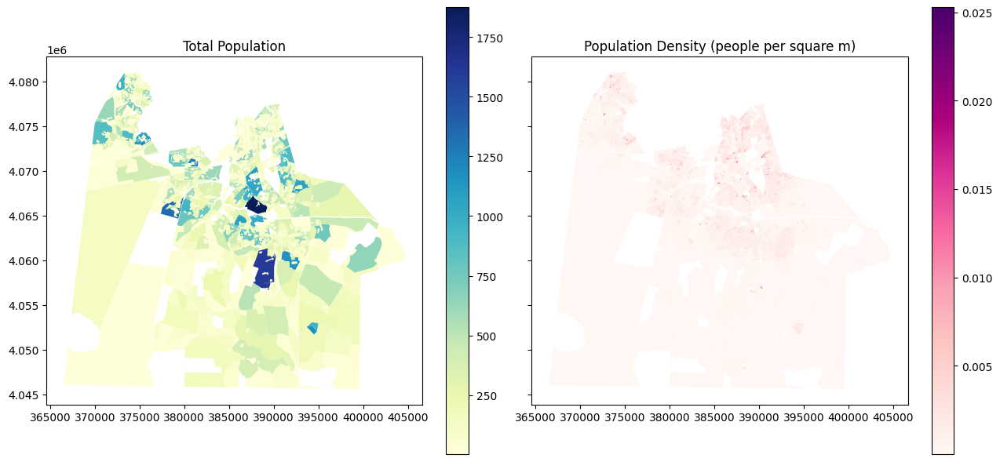

In [10]:
# Plot census block data
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 6), sharex=True, sharey=True)

ax1 = CPC_geo.plot(ax=ax1, column = 'P1_001N', legend=True, 
                   linewidth=0, cmap='YlGnBu')
ax1.set_title("Total Population")
ax2 = CPC_geo.plot(ax=ax2, column = 'pop_density', legend=True, 
                   linewidth=0, cmap='RdPu')
ax2.set_title("Population Density (people per square m)")
plt.tight_layout()

## 1.2 Load OpenStreetMap data for the residential area.

OpenStreetMap (OSM) is a collaborative, open-source mapping project. With a global community of contributors, OSM provides a free and constantly evolving map of the world. The python library, osmnx, can be applied to retrieve residential area, which represents an area of land having predominantly residential buildings such as houses or apartment buildings.

For more information about:
- osmnx python library: https://osmnx.readthedocs.io/en/stable/
- OSM residential area: https://wiki.openstreetmap.org/wiki/Tag:landuse%3Dresidential

In [11]:
# Load OpenStreetMap (OSM) data for City of Chesapeake
cpc_ox_resi = ox.features.features_from_place ('Chesapeake,Virginia', tags={'landuse':'residential'})

# Remove the non-polygon part of data
cpc_ox_resi = cpc_ox_resi.loc[cpc_ox_resi.geometry.type=='Polygon'] 

# Convert to UTM coordinate system
cpc_ox_resi = cpc_ox_resi.to_crs("epsg:32618")

Next, hexagons are created to cover the OSM residential area. This enable the deasymtric tool to conduct interpolation with smaller maping units. The h3fy from Tobler library is applied here. Note, the larger the resolution number, the smaller the hexagons.

In [17]:
# Create hexagons using Tobler h3fy function
cpc_ox_resi_hex = h3fy(cpc_ox_resi, resolution=11)

/opt/tljh/user/lib/python3.9/site-packages/pyproj/crs/crs.py:1286: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coordinate-reference-systems
  proj = self._crs.to_proj4(version=version)


To make sure all of the hexagons are inside the boundary of City of Chesapeake, remove the hexagons not intersected with the AOI boundary.

In [18]:
# Keep hexagons inside the area of interest created in section 1.1
CPC_hex = gpd.sjoin(cpc_ox_resi_hex, AOI, predicate='intersects', how='inner')
CPC_hex = CPC_hex[['geometry']] 

# Plot to see the hexagons
CPC_hex.explore(tooltip = False, popup = True )

## 1.3. Load land use and land cover data from the National Land Cover Database

The National Land Cover Database (NLCD) offers comprehensive land cover and land use data for the entire United States. If you'd like to learn more about NLCD, you can visit their website here: https://www.usgs.gov/centers/eros/science/national-land-cover-database

A 2019 NLCD for City of Chesapeake was clipped and saved in the local folder.

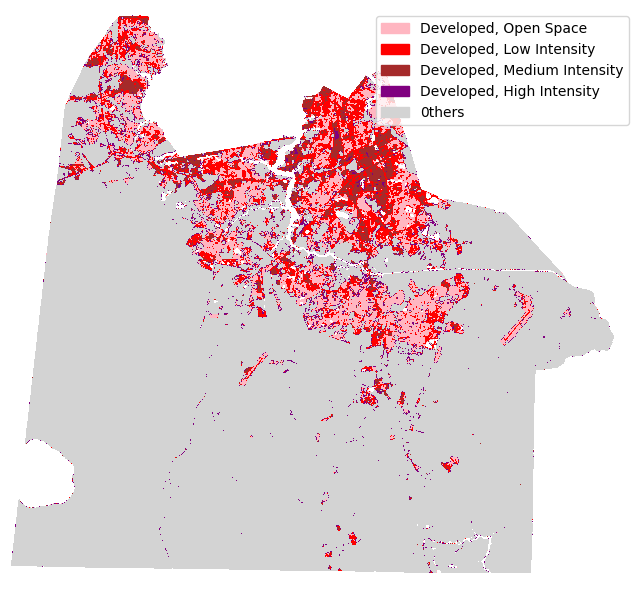

In [19]:
# Load NLCD data and make a quick map
nlcd_cpc = rioxarray.open_rasterio("AIST_NLCD_2019_CPC_16bit.tif").squeeze() # this Tiff file is with UTM projection already

# Create a color map and call specific classification for visualization
cmap = ListedColormap(["white", "lightpink", "red", "brown", "purple", "lightgray"])
norm = colors.BoundaryNorm([11, 21, 22, 23, 24, 31, 52], 7) # This define the classes

fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(nlcd_cpc, cmap=cmap, norm=norm)
legend_labels = {"lightpink": "Developed, Open Space",  # Create a legend to indicate the land use land cover type
                 "red": "Developed, Low Intensity", 
                 "brown": "Developed, Medium Intensity",
                 "purple": "Developed, High Intensity",
                 "lightgray": "0thers"}
patches = [Patch(color=color, label=label)
           for color, label in legend_labels.items()]
ax.legend(handles=patches,
          bbox_to_anchor=(1.01, 1),
          facecolor="white")
ax.set_axis_off() # Hide the X and Y becuase imshow does not plot with UTM X and Y values properly
plt.show()

## 2. Apply Tobler dasymetric mapping methods

Dasymetric mapping aims to focus on residential areas and map where the population resides. We applied the Tobler library for interpolation, which uses data from census tracts, residential areas, and land use land cover data. In Tobler, there are three mapping methods that we will apply and compare:

1. Areal Interpolation (AI): The simplest method for allocating variables based on overlapping geometries.

2. Masked Area Interpolation (MAI): Similar to areal interpolation, this method incorporates auxiliary data (e.g., NLCD) to enhance estimations.

In [20]:
# Call NLCD again as proper format for Tobler function
nlcd_cpcfile = "./AIST_NLCD_2019_CPC_16bit.tif"

source_ver = "P1_001N" # Here define what source variable to use

# Apply Areal Interpolation (AI) method
AI_popden_oxres = area_interpolate(source_df=CPC_geo, target_df=CPC_hex, 
                                   extensive_variables=[source_ver])
AI_popden_oxres["area"] = AI_popden_oxres["geometry"].area#/ 10000
AI_popden_oxres["Population_density_AI"] = AI_popden_oxres[source_ver] / AI_popden_oxres["area"]
AI_popden_oxres = AI_popden_oxres.rename(columns ={source_ver:"Total_population_AI"})

# Apply Masked Areal Interpolation (MAI) method
MAI_popden_oxres = masked_area_interpolate (source_df=CPC_geo, target_df=CPC_hex, 
                                            raster=nlcd_cpcfile, pixel_values=[21, 22, 23, 24],
                                            extensive_variables=[source_ver])
MAI_popden_oxres["area"] = MAI_popden_oxres["geometry"].area#/ 10000
MAI_popden_oxres["Population_density_MAI"] = MAI_popden_oxres[source_ver] / MAI_popden_oxres["area"]
MAI_popden_oxres = MAI_popden_oxres.rename(columns ={source_ver:"Total_population_MAI"})


/opt/tljh/user/lib/python3.9/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/opt/tljh/user/lib/python3.9/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


/tmp/ipykernel_69183/3839946934.py:23: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


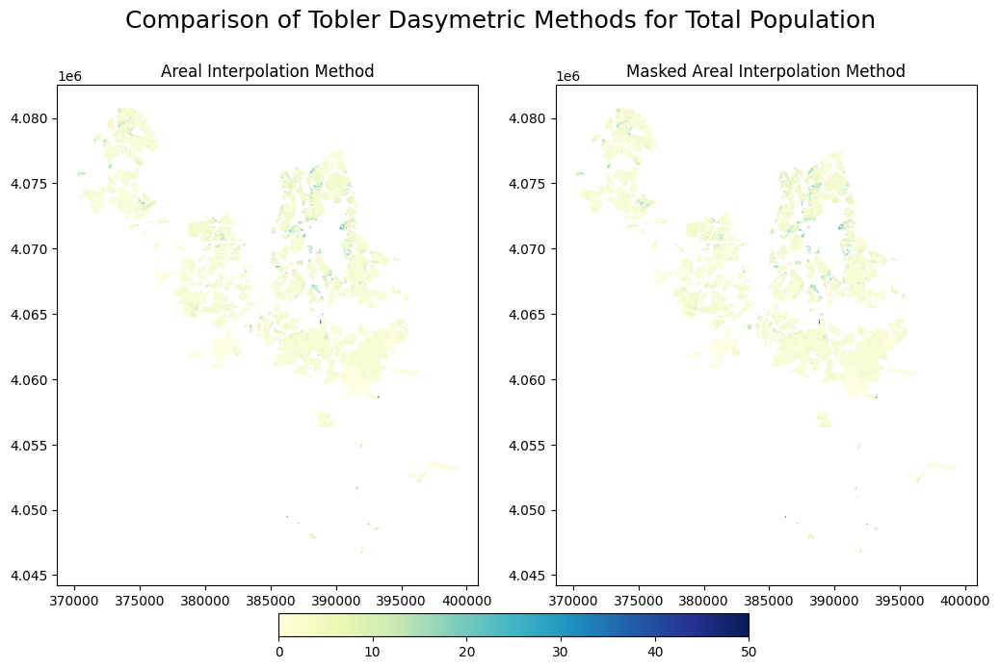

In [21]:
# Make a side-by-side map showing the outcomes
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10.5, 6.5))
fig.suptitle ("Comparison of Tobler Dasymetric Methods for Total Population",  fontsize=18)

# Define the minimum and maximum values for plotting
vmin = 0
vmax = 50 # set to 50 for better visualization

colormap = "YlGnBu"

# Plot Areal Interpolation result
ax[0] = AI_popden_oxres.plot(ax=ax[0], column = 'Total_population_AI', linewidth=0, vmin=vmin, vmax=vmax, cmap=colormap)
ax[0].set_title("Areal Interpolation Method")

# Plot Masked Areal Interpolation result
ax[1] = MAI_popden_oxres.plot(ax=ax[1], column = 'Total_population_MAI', linewidth=0, vmin=vmin, vmax=vmax, cmap=colormap)
ax[1].set_title("Masked Areal Interpolation Method")

# Define color bar on the bottom
patch_col = ax[0].collections[0]
cb = fig.colorbar(patch_col, ax=ax, orientation='horizontal', shrink= 0.6, location = "bottom", anchor=(0.5, -1.7))
plt.subplots_adjust(bottom=0.05)
plt.tight_layout()